## Lending club data Exploratory Data Analysis, feature engineering and cleaning


In [1]:
#from pandas_profiling import ProfileReport
import matplotlib.pyplot as mp
from collections import Counter
import math
import scipy.stats as ss
from sklearn.preprocessing import LabelEncoder
import pandas as pd
import plotly as pf
import numpy as np
#.figure_factory as ff
import seaborn as sns
import plotly.express as px
from collections import Counter
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from plotly.offline import iplot, init_notebook_mode,plot
init_notebook_mode()
from urllib.request import urlopen
import json
from plotly.colors import n_colors
cm = sns.light_palette("green", as_cmap=True)
with open('geoson-counties-fips.json') as json_:#urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(json_)




/Users/abhinavgairola/miniconda3/envs/raven_libraries/lib/python3.7/site-packages/xarray/core/merge.py:17: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  PANDAS_TYPES = (pd.Series, pd.DataFrame, pd.Panel)


In [2]:
def plotter(type_of_plot,dataframe,R,G,B,*args):
    """ Enter the type of plot needed and the keys and the color
        @In, type of plot needed
        @In, dataframe
        @In, R G B color code
        @In, keys
    """
    if type_of_plot == 'line':
        fig_ = go.Figure()
        #fig = go.Figure()
        key_1, key_2 = args
        fig_.add_trace(go.Scatter(x=dataframe[key_1], y=dataframe[key_2],
                         line=dict(color='rgb('+str(R)+','+str(G)+','+str(B)+')', width=4)))
        fig_.update_layout(template="ggplot2")
        #fig_.show()
    if type_of_plot == 'bar':
        key_1,key_2,key_3 = args
        fig_ = px.bar(dataframe,x=key_1, y=key_2,color=key_3,height=800,width=1000,orientation='v')
        fig_.update_layout(template="ggplot2")
        
    if type_of_plot  == 'density':
        hist_data, group_labels,bins = args
        fig_ = ff.create_distplot(hist_data,group_labels,bin_size=bins,show_rug=False)
        fig_.update_layout(template="ggplot2")
        
    if type_of_plot == 'scatter_matrix':
        h1, w1=args
        fig_ = px.scatter_matrix(dataframe,height=h1,width=w1)
        fig_.update_layout(template="ggplot2")
        
    if type_of_plot == 'pie':
        key_1, key_2, title_ = args
        fig_ = px.pie(dataframe, values=key_1, names=key_2, title=title_)
        fig_.update_layout(template="ggplot2")
        
    if type_of_plot == 'donut_pie':
        values, labels = args
        fig_ = go.Figure(data=[go.Pie(labels=labels, values=values,hole=.3)])
        fig_.update_layout(template="ggplot2")
        
    if type_of_plot == 'histogram':
        key_1, key_2 = args
        fig_ = px.histogram(dataframe, x=key_1, color=key_2,nbins=100)#, barmode="overlay")
        fig_.update_layout(template="ggplot2")
    if type_of_plot == 'scatter_':
        key_1,key_2,key_3,key_4 = args
        fig_ = px.scatter(dataframe, x=key_1, y=key_2,size=key_3,color=key_4, log_x=True, size_max=60)
        fig_.update_layout(template="ggplot2")
    if type_of_plot == 'violin':
        key_y,key_x,key_color=args
        fig_ = px.violin(dataframe, y=dataframe[key_y], x=dataframe[key_x], color=dataframe[key_color], box=True
                        )#hover_data=dataframe.columns)
        
    if type_of_plot == 'bar_h':
        key_1,key_2,key_3 = args
        fig_ = px.bar(dataframe,x=key_1, y=key_2,color=key_3,height=800,width=1000,orientation='h')
        fig_.update_layout(template="ggplot2")
        
    return fig_
    

In [3]:
def conditional_entropy(x,y):
    """ computes entropy of x given y """
    y_counter = Counter(y)
    xy_counter = Counter(list(zip(x,y)))
    total_occurrences = sum(y_counter.values())
    entropy = 0
    for xy in xy_counter.keys():
        p_xy = xy_counter[xy] / total_occurrences
        p_y = y_counter[xy[1]] / total_occurrences
        entropy += p_xy * math.log(p_y/p_xy)
    return entropy

def theil_u(x,y):
    """" These methods are taken from a medium post by Shaked Zychlinski"""
    s_xy = conditional_entropy(x,y)
    x_counter = Counter(x)
    total_occurrences = sum(x_counter.values())
    p_x = list(map(lambda n: n/total_occurrences, x_counter.values()))
    s_x = ss.entropy(p_x)
    if s_x == 0:
        return 1
    else:
        return (s_x - s_xy) / s_x

In [4]:
def cramers_v(x, y):
    """Compute Cramers V correlation"""
    confusion_matrix = pd.crosstab(x,y)
    chi2 = ss.chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2/n
    r,k = confusion_matrix.shape
    phi2corr = max(0, phi2-((k-1)*(r-1))/(n-1))
    rcorr = r-((r-1)**2)/(n-1)
    kcorr = k-((k-1)**2)/(n-1)
    return np.sqrt(phi2corr/min((kcorr-1),(rcorr-1)))

In [5]:
def additive_smoothing(df, by, on, m):
    """ computes additive smoothing or Laplace smoothing
    @In, dataframe
    @In, by--feature to groupby
    @In, on-- target feature
    @In , m-- weight to be given to the global mean
    @Out, Laplace smoothed means
    """
    global_mean_target = df[on].mean()

    # Compute the number of values and the mean of each group
    agg = df.groupby(by)[on].agg(['count', 'mean'])
    counts = agg['count']
    means = agg['mean']

    # Compute the "smoothed" means
    smooth = (counts * means + m * global_mean_target) / (counts + m)
    return smooth#df[by].map(smooth)

### Since the supplied csv is huge I am going to read it in chunks

In [2]:
chunks = pd.read_csv('Data/Lending_Club.csv',chunksize=100000,low_memory=False)
df = pd.concat(chunks)


In [3]:
## explore the keys of the data
key = df.keys()

In [4]:
list(key)

['id',
 'member_id',
 'loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'term',
 'int_rate',
 'installment',
 'grade',
 'sub_grade',
 'emp_title',
 'emp_length',
 'home_ownership',
 'annual_inc',
 'verification_status',
 'issue_d',
 'loan_status',
 'pymnt_plan',
 'url',
 'desc',
 'purpose',
 'title',
 'zip_code',
 'addr_state',
 'dti',
 'delinq_2yrs',
 'earliest_cr_line',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'mths_since_last_delinq',
 'mths_since_last_record',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'initial_list_status',
 'out_prncp',
 'out_prncp_inv',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'last_pymnt_d',
 'last_pymnt_amnt',
 'next_pymnt_d',
 'last_credit_pull_d',
 'last_fico_range_high',
 'last_fico_range_low',
 'collections_12_mths_ex_med',
 'mths_since_last_major_derog',
 'policy_code',
 'application_type',
 'annual_inc_joint',
 '

In [9]:
df.describe().style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})
## Checking the description

,member_id,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,annual_inc,dti,delinq_2yrs,fico_range_low,fico_range_high,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,revol_bal_joint,sec_app_fico_range_low,sec_app_fico_range_high,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_acc,sec_app_revol_util,sec_app_open_act_il,sec_app_num_rev_accts,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,deferral_term,hardship_amount,hardship_length,hardship_dpd,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,settlement_amount,settlement_percentage,settlement_term
count,0.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260664.000000,2258957.000000,2260639.000000,2260668.000000,2260668.000000,2260638.000000,1102166.000000,359156.000000,2260639.000000,2260639.000000,2260668.000000,2258866.000000,2260639.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260668.000000,2260523.000000,580775.000000,2260668.000000,120710.000000,120706.000000,2260639.000000,2190392.000000,2190392.000000,1394538.000000,1394539.000000,1394539.000000,1394539.000000,1350744.000000,1394539.000000,1191818.000000,1394539.000000,1394539.000000,1394539.000000,1394320.000000,2190392.000000,1394539.000000,1394538.000000,1394538.000000,2210638.000000,2190322.000000,2185733.000000,2184597.000000,2260523.000000,2260639.000000,2121597.000000,2190391.000000,2190391.000000,2190392.000000,2210638.000000,2187256.000000,519701.000000,1965233.000000,740359.000000,2190392.000000,2190392.000000,2190392.000000,2202078.000000,2190392.000000,2190392.000000,2190392.000000,2190391.000000,2190392.000000,2202078.000000,2107011.000000,2190392.000000,2190392.000000,2190392.000000,2190237.000000,2185289.000000,2259303.000000,2260563.000000,2190392.000000,2210638.000000,2210638.000000,2190392.000000,108020.000000,108021.000000,108021.000000,108021.000000,108021.000000,108021.000000,106184.000000,108021.000000,108021.000000,108021.000000,108021.000000,35942.000000,10917.000000,10917.000000,10917.000000,10917.000000,8651.000000,10917.000000,10917.000000,34246.000000,34246.000000,34246.000000
mean,nan,15046.931228,15041.664057,15023.437745,13.092829,445.806823,77992.428687,18.824196,0.306879,698.588205,702.588400,0.576835,34.540916,72.312842,11.612402,0.197528,16658.458078,50.337696,24.162552,4206.891439,4205.965357,12082.556829,12064.394655,9505.771588,2431.387654,1.518453,143.879135,23.982566,3429.345942,687.660995,675.539730,0.018146,44.164220,1.000000,123624.636701,19.251817,0.004148,232.731739,142492.195202,0.934420,2.779407,0.676431,1.562752,21.222

In [10]:
Data_types_counts = (df.dtypes.value_counts().sort_values())
## Checking the data types
Data_types_counts

object      38
float64    113
dtype: int64

In [11]:
vals=Data_types_counts.values
vals[0]

38

In [12]:
Data_type_counts_frame = pd.DataFrame(data={'Object':[vals[0]],'Float':[vals[1]]})
Data_type_counts_frame = Data_type_counts_frame.melt(var_name=['Data-Type'],value_vars=['Object','Float'])

### Visualizing types of data

In [13]:
figure_data_type = plotter('bar',Data_type_counts_frame,0,0,0,'Data-Type','value','value')#plotter('donut_pie',df_emp,0,0,0,list(df_emp['fico_range_high'].values),list(df_emp['index'].values))
#plot(figure_fico,show_link=True,filename='plot_fico_high.html')
figure_data_type.show()

## Now checking which columns have a high number of NaN

In [14]:
df_inter = df.isna().mean()
df_inter.sort_values()
#keys = list(df_inter.keys())
#df_inter
#idx_key = list(df_inter.keys())
#keys = [i for i in idx_key if df_inter[i] >=0.99]


id                                            0.000000
fico_range_high                               0.000015
hardship_flag                                 0.000015
revol_bal                                     0.000015
initial_list_status                           0.000015
                                                ...   
hardship_reason                               0.995171
hardship_dpd                                  0.995171
hardship_loan_status                          0.995171
orig_projected_additional_accrued_interest    0.996173
member_id                                     1.000000
Length: 151, dtype: float64

## Removing columns where there is 100% NaN

In [15]:
idx_key = list(df_inter.keys())
idx_key
df_2 = df.copy()
df_2.drop((i for i in idx_key if df_inter[i] == 1.0), axis=1, inplace =True)


In [16]:
df_2.reset_index(drop=True,inplace=True)

In [17]:
df_2.isna().mean()

id                       0.000000
loan_amnt                0.000015
funded_amnt              0.000015
funded_amnt_inv          0.000015
term                     0.000015
                           ...   
settlement_status        0.984852
settlement_date          0.984852
settlement_amount        0.984852
settlement_percentage    0.984852
settlement_term          0.984852
Length: 150, dtype: float64

### member_id has been removed as it was 100% NaN

In [18]:
Object_data = df_2.select_dtypes(include=['object'])
float_data = df_2.select_dtypes(include = ['float64'])
## Separate the object and float data types

In [19]:
#dicti = list(df_2['loan_status'].unique())
#print(dicti)
#Entry = 0
#Entry = 1
#convertor = {j:i for i,j in enumerate(dicti) if type(j) == str}
#convertor

### Visualizing the percentage of people under different grades 

In [20]:
df_3 = pd.DataFrame(df_2['grade'].value_counts().sort_index())
df_3.reset_index(level=0, inplace=True)



In [21]:
figure_grade = plotter('donut_pie',df_3,0,0,0,list(df_3['grade'].values),list(df_3['index'].values))
#plot(figure_grade,show_link=True,filename='plot_grade.html')
figure_grade.show()
#bar chart

### The donut plot above shows that a significant portion of lenders are placed in the category B followed closely by C. It might be the case that the people placed in category B are preferred by the company? This question need some investigation.

### How many of them own their house, rent or Mortgage?

In [22]:
df_home = pd.DataFrame(df_2['home_ownership'].value_counts().sort_index())
df_home.reset_index(level=0, inplace=True)
df_home.style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

,index,home_ownership
0,ANY,996
1,MORTGAGE,1111450
2,NONE,54
3,OTHER,182
4,OWN,253057
5,RENT,894929


In [23]:
figure_home = plotter('donut_pie',df_home,0,0,0,list(df_home['home_ownership'].values),list(df_home['index'].values))
#plot(figure_home,show_link=True,filename='plot_home.html')
figure_home.show()

### A significant numbers of lenders are paying their mortages--it "appears" like the lending club feel more secure while lending money to the people who are paying their mortgages followed closely by the people who are living in the rented dwellings.

### What is the fico score of the lenders?

In [24]:
df_emp = pd.DataFrame(df_2['fico_range_high'].value_counts().sort_index())
df_emp.reset_index(level=0, inplace=True)
df_emp = df_emp.rename(columns={'index':'Fico_Score_high','fico_range_high':'Counts'})
#df_emp

In [25]:
figure_fico = plotter('bar',df_emp,0,0,0,'Fico_Score_high','Counts','Counts')#plotter('donut_pie',df_emp,0,0,0,list(df_emp['fico_range_high'].values),list(df_emp['index'].values))
#plot(figure_fico,show_link=True,filename='plot_fico_high.html')
figure_fico.show()

In [26]:
df_emp_ = pd.DataFrame(df_2['fico_range_low'].value_counts().sort_index())
df_emp_.reset_index(level=0, inplace=True)
df_emp_ = df_emp_.rename(columns={'index':'Fico_Score_Low','fico_range_low':'Counts'})
#df_emp_.keys()

In [27]:
figure_emp_ = plotter('bar',df_emp_,0,0,0,'Fico_Score_Low','Counts','Counts')#plotter('donut_pie',df_emp_,0,0,0,list(df_emp_['fico_range_low'].values),list(df_emp_['index'].values))
#plot(figure_emp_,show_link=True,filename='plot_fico_high.html')
figure_emp_.show()
#distribution

### Plotting the fico score counts reveal that a significant number of people who are taking loans fall in the category 660-664 and subsequently tapered off with increasing the fico score. This may be true as the people with high fico score may not want to lend money at all.

In [28]:
df_loan = pd.DataFrame(df_2['loan_status'].value_counts().sort_index())
df_loan.reset_index(level=0, inplace=True)
df_loan = df_loan.rename(columns={'index':'Loan_status','loan_status':'Counts'})
df_loan = df_loan.sort_values(by=['Counts'],ascending=False)

In [29]:
figure_loan = plotter('bar',df_loan,0,0,0,'Loan_status','Counts','Counts')#plotter('donut_pie',df_loan,0,0,0,list(df_loan['loan_status'].values),list(df_loan['index'].values))
#plot(figure_loan,show_link=True,filename='plot_loan_status.html')
figure_loan.show()

### Lending club has a high number of customers either in the Fully paid and or Current range. This means that the company's model of lending the money is working well for them--the money which is going out is coming back too with some interest paid.

In [30]:
df_emp_title = pd.DataFrame(df_2['emp_length'].value_counts().sort_index())
df_emp_title.reset_index(level=0, inplace=True)
df_emp_title = df_emp_title.rename(columns={'index':'Employment_Length','emp_length':'Counts'})
df_emp_title = df_emp_title.sort_values(by=['Counts'],ascending=False)

In [31]:
figure_length = plotter('bar',df_emp_title,0,0,0,'Employment_Length','Counts','Counts')#plotter('donut_pie',df_emp_title,0,0,0,list(df_emp_title['emp_length'].values),list(df_emp_title['index'].values))
#plot(figure_length,show_link=True,filename='plot_loan_status.html')
figure_length.show()
#employment length

### By grouping the data with employment length shows that the lending club customers have  signficant number of people who have a good employment history i.e. more than 10+ years.

In [32]:
df_groupby_emp = df_2.groupby(['emp_length']).mean()
#df_groupby_fico_range_low = df_2.groupby('fico_range_low').first()

In [33]:
df_groupby_emp.reset_index(level=0, inplace=True)
#df_groupby_fico_range_low.reset_index(level=0, inplace=True)

In [34]:
figure_scatter_group_emp = plotter('scatter_',df_groupby_emp,0,0,0,'loan_amnt','installment','int_rate','emp_length')#px.scatter(purpose, x="loan_amnt", y="int_rate",
         #size="installment",color='purpose', log_x=True, size_max=100)
figure_scatter_group_emp.show()

In [35]:
df_groupby_grade_2 = df_2.groupby('grade').mean()
df_groupby_grade_2.reset_index(level=0, inplace=True)
df_groupby_grade_2.style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

,grade,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,annual_inc,dti,delinq_2yrs,fico_range_low,fico_range_high,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,revol_bal_joint,sec_app_fico_range_low,sec_app_fico_range_high,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_acc,sec_app_revol_util,sec_app_open_act_il,sec_app_num_rev_accts,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,deferral_term,hardship_amount,hardship_length,hardship_dpd,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,settlement_amount,settlement_percentage,settlement_term
0,A,14603.343210,14598.002723,14587.744268,7.084545,437.846530,89902.403133,16.238648,0.173167,728.992326,732.993079,0.349509,37.461119,77.243769,11.932291,0.106603,18260.623192,37.064114,25.274329,4624.833909,4624.271828,10804.826362,10794.378611,9707.794950,1069.924208,0.482386,26.624803,4.448981,2850.310483,733.007087,727.342741,0.009640,46.767483,1.000000,141466.084298,16.630310,0.001346,127.522056,173241.203730,0.736457,2.678679,0.498440,1.280294,23.697416,34005.508613,63.262498,1.026317,2.239798,6487.369003,45.512661,49747.577932,0.752906,1.479336,1.481700,3.753222,16336.714749,22621.369138,41.417938,0.004217,4.155137,130.896181,203.174711,16.757238,9.843788,1.881283,28.546477,40.393763,8.386796,37.397150,0.311009,3.606718,5.121754,5.218427,8.495158,8.391106,8.518635,14.823038,5.091835,11.992360,0.000186,0.000968,0.038966,1.622431,96.224253,22.972098,0.069866,0.027441,228324.054444,52200.915955,35655.418555,45642.424533,33359.464921,697.994338,701.994385,0.497051,1.852371,11.663741,46.489331,2.855013,13.325548,0.033168,0.045718,39.568498,3.000000,57.724234,3.000000,11.056569,173.128550,9636.718394,105.745985,3614.041361,47.888341,11.570976
1,B,14173.338199,14168.424604,14150.038687,10.675806,415.671787,78813.567867,17.966630,0.308462,699.831401,703.831538,0.484182,34.637664,72.208389,11.474028,0.203080,16564.879623,48.943646,24.126534,4032.789954,4030.831173,11280.631945,11263.091644,9450.006026,1758.234585,1.038099,71.353233,11.847736,3118.597919,696.907039,687.921912,0.018769,44.167866,1.000000,127304.121471,18.430656,0.003914,245.801210,143093.160174,0.851023,2.715814,0.602768,1.439360,22.491902,34464.910981,68.072535,1.201862,2.603168,5836.759882,55.787216,34752.367671,0.916819,1.435874,1.855963,4.208887,13785.824536,11486.051974,56.308644,0.008672,11.013349,127.054717,186.415885,14.794100,8.880734,1.588616,26.136680,39.480341,7.512708,35.857827,0.510841,3.646083,5.512751,4.768997,7.838473,8.230000,8.179138,14.128813,5.459563,11.488868,0.000685,0.002545,0.083539,1.878464,93.932633,39.719460,0.133716,0.047597,179418.515499,49717.286644,23411.932050,42662.250000,33977.827760,675.48873

In [36]:
figure_scatter_group = plotter('scatter_',df_groupby_grade_2,0,0,0,'loan_amnt','installment','int_rate','grade')#px.scatter(purpose, x="loan_amnt", y="int_rate",
	         #size="installment",color='purpose', log_x=True, size_max=100)
figure_scatter_group.show()

### Here I have grouped the data by grades and plotted them as bubble chart. Mean loan amount and mean installments show a linear behavior while the meant interest rate tend to grow sharply as we move from category B to G with an exception of category A which falls in between the categroy B and C.

### At a more granular level how the interest rate is distributed within each category?

In [37]:
A = df_2[df_2['grade']=='A']
B = df_2[df_2['grade']=='B']
C = df_2[df_2['grade']=='C']
D = df_2[df_2['grade']=='D']
E = df_2[df_2['grade']=='E']
F = df_2[df_2['grade']=='F']
G = df_2[df_2['grade']=='G']

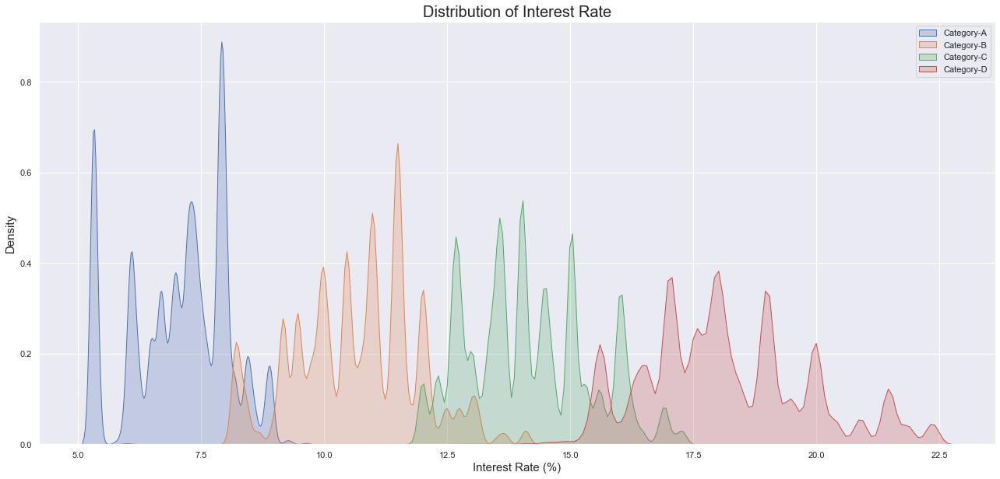

In [38]:
#figure = plotter('histogram',A,0,0,0,'loan_amnt')
x0= A['int_rate'].values
x1= B['int_rate'].values
x2= C['int_rate'].values
x3= D['int_rate'].values
x4= E['int_rate'].values
df_20000 = pd.DataFrame(dict(
    Grades=np.concatenate((["A"]*len(x0), ["B"]*len(x1),["C"]*len(x2),["D"]*len(x3),["E"]*len(x4))), 
    interest_rate  =np.concatenate((x0,x1,x2,x3,x4))))
#figure = plotter('histogram',df_20000,0,0,0,"interest_rate","Grades")#px.histogram(df_20000, x="interest_rate", color="Grades", barmode="overlay")
#figure.show()
sns.set()
fig = mp.figure(figsize=(22,10))
sns.kdeplot(x0,fill=True, label = 'Category-A')
sns.kdeplot(x1,fill=True, label = 'Category-B')
sns.kdeplot(x2,fill=True, label = 'Category-C')
sns.kdeplot(x3,fill=True, label = 'Category-D')
#sns.kdeplot(x4,fill=True, label = 'Category-E')
mp.xlabel('Interest Rate (%)',fontsize=15)
mp.ylabel('Density',fontsize=15)
mp.title('Distribution of Interest Rate',fontsize=20)
mp.legend()
#sns.kdeplot(df.loc[df['TARGET'] == 0, 'int_rate'], label = 'target = 0');
mp.show()

### How the loan amount, interest rate etc is grouped with the purpose of loan?

In [39]:
purpose  = df_2.groupby('purpose').mean().reset_index(level=0)

In [40]:
purpose = purpose.sort_values(by=['loan_amnt'],ascending=True)
purpose

,purpose,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,annual_inc,dti,delinq_2yrs,fico_range_low,...,deferral_term,hardship_amount,hardship_length,hardship_dpd,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,settlement_amount,settlement_percentage,settlement_term
12,vacation,6357.995169,6355.937198,6346.113494,13.450725,203.765864,69815.777456,18.377908,0.316779,700.455717,...,3.0,75.161081,3.0,12.324324,205.816071,5480.879189,99.025405,2412.036031,48.661284,11.918288
3,educational,6614.622642,6511.733491,5069.612080,12.142146,214.345991,51280.175896,11.269033,0.183962,706.025943,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6345.495000,60.195000,0.000000
8,moving,8390.811855,8385.390833,8367.415100,14.738520,264.945157,70349.695167,17.330161,0.358826,699.125170,...,3.0,106.538030,3.0,12.742424,336.617872,8537.259545,120.470455,3165.664217,48.330739,10.782609
0,car,9393.720068,9389.608754,9367.329546,12.182095,282.744916,70224.040136,15.502546,0.319619,707.799109,...,3.0,99.918286,3.0,13.957143,299.714706,8252.836286,158.073714,3423.622453,48.285566,12.712264
7,medical,9474.190556,9469.836838,9453.213759,13.632130,288.833904,73633.453873,18.373266,0.348916,702.600589,...,3.0,108.293802,3.0,12.446281,327.684356,8146.429421,127.189421,3609.819946,49.010352,11.978320
13,wedding,10475.859873,10411.433121,10121.859611,14.154514,331.070093,69553.095911,13.975724,0.236093,705.537155,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4181.334500,49.121000,2.150000
9,other,10481.091150,10475.448401,10451.541763,14.235322,323.704264,72880.924637,17.354981,0.333128,701.298910,...,3.0,142.173085,3.0,14.064677,404.289186,9798.459668,173.504511,3637.528992,48.635664,11.807349
10,renewable_energy,10757.024221,10742.179931,10683.361059,14.728131,340.821827,73788.823855,16.766177,0.296886,700.231834,...,3.0,202.067143,3.0,15.571429,716.167500,14463.457143,260.985714,3946.078261,51.841304,9.652174
6,major_purchase,12682.430370,12673.914164,12651.892442,12.763690,375.514827,79555.699731,15.490963,0.306849,709.860442,...,3.0,157.314599,3.0,15.527426,423.126404,11923.439325,205.144599,4558.701160,48.125190,12.270042
4,home_improvement,14666.147969,14659.377264,14639.927683,12.621047,429.794559,92490.407980,16.956423,0.371993,706.761035,...,3.0,165.635950,3.0,12.758772,481.449305,12536.885760,212.015000,5018.194322,47.762656,13.098454


In [41]:
figure_purpose = plotter('bar_h',purpose,0,0,0,'loan_amnt','purpose','loan_amnt')
figure_purpose.show()

In [42]:
figure_scatter = plotter('scatter_',purpose,0,0,0,'loan_amnt','installment','int_rate','purpose')#px.scatter(purpose, x="loan_amnt", y="int_rate",
	         #size="installment",color='purpose', log_x=True, size_max=100)
figure_scatter.show()

In [43]:
term = df_2.groupby('term').mean().reset_index(level=0)
term.style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})


,term,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,annual_inc,dti,delinq_2yrs,fico_range_low,fico_range_high,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,revol_bal_joint,sec_app_fico_range_low,sec_app_fico_range_high,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_acc,sec_app_revol_util,sec_app_open_act_il,sec_app_num_rev_accts,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,deferral_term,hardship_amount,hardship_length,hardship_dpd,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,settlement_amount,settlement_percentage,settlement_term
0,36 months,12745.526879,12742.965043,12721.595073,11.947973,422.153386,75414.009671,18.299525,0.311921,698.346400,702.346593,0.577691,34.425553,71.552361,11.344336,0.203896,15446.261241,49.281468,23.432710,2881.076746,2879.964888,10706.944537,10686.102363,9030.846144,1583.977800,1.337376,90.783216,15.262711,2876.889552,689.332755,677.448442,0.019095,44.012645,1.000000,121486.971331,18.845329,0.004150,245.313108,131116.389949,0.932466,2.706901,0.656109,1.509521,21.835684,33261.464994,68.799604,1.314810,2.784532,5462.311306,56.410001,32956.329919,0.990964,1.378336,2.000538,4.468826,12670.698579,11233.093909,56.963027,0.008611,12.786553,123.274405,178.539511,13.810324,8.339177,1.430442,24.413195,39.316443,7.087142,35.725502,0.516399,3.602263,5.509567,4.678437,7.595367,8.060013,8.098353,13.753445,5.460560,11.359324,0.000666,0.002791,0.086410,2.068691,93.867224,41.335244,0.130892,0.048933,165671.847464,47618.293577,22185.627048,41094.318221,31242.748225,667.567585,671.567617,0.636093,1.410762,11.008610,57.486758,2.871882,12.166252,0.052895,0.087254,36.167996,3.000000,109.868911,3.000000,13.392209,328.102673,9225.530034,162.642997,3716.105839,48.103806,12.070763
1,60 months,20738.458614,20726.500966,20716.049134,15.924135,504.303360,84369.016088,20.122341,0.294411,699.186206,703.186404,0.574719,34.834033,74.365857,12.275336,0.181778,19656.302197,52.949312,25.967469,7485.720141,7485.253492,15484.538335,15473.003978,10680.294078,4527.089087,1.966269,275.188905,45.547353,4795.607666,683.526623,670.819356,0.015799,44.567616,1.000000,126552.590734,19.808570,0.004143,201.895471,170373.691285,0.939434,2.965458,0.728580,1.699342,19.674642,41267.846216,69.988742,1.226811,2.661115,6689.316766,58.629086,38538.626178,1.069068,1.731262,2.129376,4.651751,15697.476250,11790.180316,60.201272,0.008101,11.339257,131.665549,188.726896,14.548016,8.195243,1.863054,25.905385,39.268573,6.871241,35.929568,0.460524,3.856964,5.923338,5.009514,8.047561,9.279667,8.609678,14.620270,5.865669,12.288815,0.000566,0.002869,0.074428,2.096519,94.720815,45.136554,0.121525,0.041425,209053.379138,59407.031740,25676.361666,50196.864823,3

In [44]:
figure_term = plotter('donut_pie',term,0,0,0,list(term['loan_amnt'].values),list(term['term'].values))
#plot(figure_term,show_link=True,filename='plot_term.html')
figure_term.show()

### How the median of the loan amount, interest rate and annual income is distributed accross the states?

In [56]:
region_data = df_2.groupby('addr_state')[['loan_amnt','annual_inc']].median().reset_index(level=0)
#region_data = region_data.drop(12,axis=0)

In [57]:
fig_ = go.Figure(data=go.Choropleth(
    locations=region_data['addr_state'], # Spatial coordinates
    z = region_data['loan_amnt'].astype(float), # Data to be color-coded
    locationmode = 'USA-states', # set of locations match entries in `locations`
    colorscale = 'hot',
    colorbar_title = "Loan-Amount",
))

fig_.update_layout(
    title_text = 'Median-Loan distribution across the states',
    geo_scope='usa', # limite map scope to USA
)
#plot(fig_,show_link=True,filename='plot_geo_loan.html')

fig_.show()

In [58]:
fig_2 = go.Figure(data=go.Choropleth(
    locations=region_data['addr_state'], # Spatial coordinates
    z = region_data['annual_inc'].astype(float), # Data to be color-coded
    locationmode = 'USA-states', # set of locations match entries in `locations`
    colorscale = 'hot',
    colorbar_title = "Annual-Income",
))

fig_2.update_layout(
    title_text = 'Median annual income',
    geo_scope='usa', # limite map scope to USA
)
#plot(fig_,show_link=True,filename='plot_geo_loan.html')

fig_2.show()

In [60]:
float_2 = float_data.reset_index(level=0)
filter_20 = float_2.iloc[0:5000,0:20]
filter_20.keys()

Index(['index', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'int_rate',
       'installment', 'annual_inc', 'dti', 'delinq_2yrs', 'fico_range_low',
       'fico_range_high', 'inq_last_6mths', 'mths_since_last_delinq',
       'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'out_prncp'],
      dtype='object')

### How the defaulters and the people who returned the loan are distributed accross the states?

In [61]:
#convertor

In [62]:
loan_status_state = pd.DataFrame(df_2[df_2['loan_status']=='Charged Off'].groupby('addr_state')['loan_status'].count().sort_values(ascending=True))


In [63]:
loan_status_state.reset_index(inplace=True)

In [64]:
loan_status_state.rename(columns={'addr_state':'State','loan_status':'Charged-off'},inplace=True)

In [65]:
figure_purpose_loan = plotter('bar_h',loan_status_state,0,0,0,'Charged-off','State','Charged-off')
figure_purpose_loan.show()

In [66]:
loan_status_state_paid = pd.DataFrame(df_2[df_2['loan_status']=='Current'].groupby('addr_state')['loan_status'].count().sort_values(ascending=True))

In [67]:
loan_status_state_paid.reset_index(inplace=True)

In [68]:
loan_status_state_paid.rename(columns={'addr_state':'State','loan_status':'Current'},inplace=True)

In [69]:
figure_purpose_loan = plotter('bar_h',loan_status_state_paid,0,0,0,'Current','State','Current')
figure_purpose_loan.show()

### CA leads in the pay back of the loan followed by TX and NY

### How the interest rate is distributed between different categories of loan status?

In [70]:
defaulters = df_2[df_2['loan_status']=='Default']

In [71]:
loan_payers = df_2[df_2['loan_status']=='Current']

In [72]:
charged_off = df_2[df_2['loan_status']=='Charged Off']

In [73]:
df_interest_rate = pd.DataFrame({'Charged-off':charged_off['int_rate'],'Payers':loan_payers['int_rate']})

In [74]:
df_interest_rate.head(5).style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

,Charged-off,Payers
3,nan,14.850000
10,nan,12.880000
11,nan,12.880000
13,19.480000,nan
18,nan,8.490000


In [75]:
fig_ = plotter('density',loan_payers,0,0,0,[charged_off['int_rate'],loan_payers['int_rate']],['Charged-off loans','Payers'],1.1)
fig_.show()

### Clearly payers fall in the range where the interest is charged at a lower rate.

### Uptill now I have plotted either the average values of the various features of the data in a variety of ways. Further to get a better estimate of the statistical features of the data I will make use of the violin plot for the interest rate on grade and states etc.

In [76]:
## Plotly's violin plot doesn't like NaN values so I am going to manually remove them and make a new dataframe
## and pass it to plotly function
df_grade = pd.DataFrame(data = {'Interest':df_2['int_rate'].dropna(),'Grade':df_2['grade'].dropna()})

In [77]:
#fig_violin = plotter('violin',df_grade,0,0,0,'Interest','Grade','Grade')#px.violin(df_grade, y='Interest',x='Grade',color='Grade')
#fig_violin.show()

### Reverting back to seaborn beacause size of the notebook is greater than 100 mb

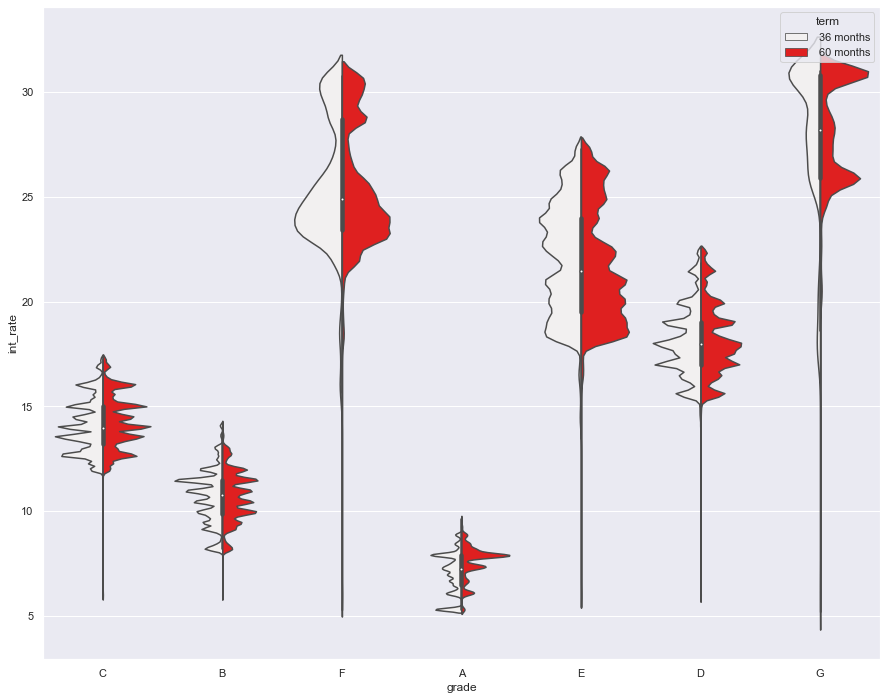

In [78]:
fig = mp.figure(figsize=(15,12))
sns.violinplot(x="grade",y="int_rate",data=df_2,hue="term", split=True,color='red')
mp.show()

### Not only the grade 'A' has the minimal value of the median. The dispersion of interest is the least in category A. Clearly from the sheer interest rate point of view it is good to be in this categroy. The above plot further differentiate the data by their tem period. 

In [79]:
## To check a rough correlation of the variables

In [80]:
fig_scatter = plotter('scatter_matrix',filter_20,0,0,0,5000,5000)
fig_scatter.show()

### Loan amount and installment are showing a mostly linear behavior but with heteroskedastic behavior. 

### Is there are a strong monotonic relationship between interest rate and  loan amount? We can explore it using Spearmans Rank correlation coefficient.
### More can be learned about it from this great resource https://statistics.laerd.com/statistical-guides/spearmans-rank-order-correlation-statistical-guide.php Its definition is$\frac{1-6\sum d_{i}^2}{n(n^2-1)}$ here 'd' is the distance between the ranks of the data point.

In [81]:
df_loan_int = pd.DataFrame({'Loan_amnt':filter_20['loan_amnt'],'Installment':filter_20['installment'],'Interest':filter_20['int_rate'],'Annual Income':filter_20['annual_inc']})

In [82]:
corr_spearman = df_loan_int.corr(method='spearman')

In [83]:
corr_spearman.values

array([[ 1.        ,  0.96112881,  0.1477271 ,  0.46415442],
       [ 0.96112881,  1.        ,  0.13490544,  0.44140613],
       [ 0.1477271 ,  0.13490544,  1.        , -0.13461241],
       [ 0.46415442,  0.44140613, -0.13461241,  1.        ]])

In [84]:
fig_cor = px.imshow(corr_spearman)
fig_cor.show()

### Very high spearman rank correlation means as we increase the rank of one the other will increase montonically. This is true for loan and installment. Means these two variables are highly correlated. While the other parameters doesn't increase monotonically. 

### We can also understand the linear dependence between variable using the pearson correlation

In [85]:
fig_cor_2 = px.imshow(df_loan_int.corr(method='pearson'))
fig_cor_2.show()

### This is a credit default problem and the loan status is a categorical variable. That is why I will encode it first. It has 10 possible values so one hot encoding will create additional features. Without that I will just encode the Charged off and put everything to 0. 

In [86]:
#labelencoder = LabelEncoder()
#df_2['loan_status_numeric'] = ''
df_2['loan_status_binary']=''


### Some more cleaning and then storing the dataframe in a cleaner format for further analysis

In [87]:
mask = (df_2['loan_status'].isnull())
#transform = labelencoder.fit_transform(df_2['loan_status'][~mask])
#inverse=labelencoder.inverse_transform(transform)
#list(inverse)

In [88]:
#df_2['loan_status_numeric'][~mask] = transform#labelencoder.fit_transform(df_2['loan_status_coded'][~mask])
#df_2['loan_status_numeric'][mask] = np.nan
df_2['loan_status_binary'][~mask] = (df_2['loan_status'] == 'Charged Off').astype('float64')
df_2['loan_status_binary'][mask]= 0
## since I don't care about other categories--this simply goes to 0.
df_2['loan_status_binary']=df_2['loan_status_binary'].astype('float64')

### For this project I am trying to predict the default. Therefore I can encode all other categories to 0 other than the Charged Off.

In [89]:
#df_2['loan_status_numeric'].fillna(max(df_2['loan_status_numeric'].unique())+1,inplace=True)
df_2['loan_status_binary'].dtype

dtype('float64')

In [90]:
### df_2['loan_status_numeric'] = df_2['loan_status'].map(convertor)
## This can be another solution to encode the loan_status variable
#df_2['loan_status_numeric']

In [91]:
#df_2['loan_status_binary'] = (df_2['loan_status_numeric'] == 0).astype('float64')

In [92]:
df_2[['loan_status','loan_status_binary']].head(20).style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})


,loan_status,loan_status_binary
0,Fully Paid,0.000000
1,Fully Paid,0.000000
2,Fully Paid,0.000000
3,Current,0.000000
4,Fully Paid,0.000000
5,Fully Paid,0.000000
6,Fully Paid,0.000000
7,Fully Paid,0.000000
8,Fully Paid,0.000000
9,Fully Paid,0.000000


In [93]:
#df_2.to_csv('Data/Lending_Club_clean.csv')
df_2.term

0           36 months
1           36 months
2           60 months
3           60 months
4           60 months
              ...    
2260696     60 months
2260697     60 months
2260698     60 months
2260699           NaN
2260700           NaN
Name: term, Length: 2260701, dtype: object

### Term information shouldn't affect the loan default.

In [94]:
df_2.drop(['term'],axis=1,inplace=True)

In [95]:
df_2.desc.unique()

array([nan,
       'We knew that using our credit cards to finance an adoption would squeeze us, but then medical and other unexpected expenses made the situation almost impossible. We are a stable family in a stable community. We just need to break a cycle of debt that is getting worse.',
       "I had a bad year two years ago, with some late and missed payments. I'm doing much better now, but I've got fees and some higher interest bits that have added up on top of the other stuff, and it's a little crazy. I'm hoping doing it thru Lending Club will make it easier - and cheaper - to pay off.",
       ...,
       'This loan will be used solely to consolidate credit card debts accrued while wife was/is unemployed.',
       'I have recently purchased and built a new home that I have always dreamed of having.  I would like to complete the project by putting a hottub in my backyard, however; I am not happy with the rate I  have been offered from GE to finance the spa.  I am paying cash for 

### Clearly I am not going to use these descriptive text for making a credit default prediction.

In [96]:
df_2.drop(['desc'],axis=1,inplace=True)

In [97]:
df_2['url'].unique()

array(['https://lendingclub.com/browse/loanDetail.action?loan_id=68407277',
       'https://lendingclub.com/browse/loanDetail.action?loan_id=68355089',
       'https://lendingclub.com/browse/loanDetail.action?loan_id=68341763',
       ...,
       'https://lendingclub.com/browse/loanDetail.action?loan_id=88985880',
       'https://lendingclub.com/browse/loanDetail.action?loan_id=88224441',
       'https://lendingclub.com/browse/loanDetail.action?loan_id=88215728'],
      dtype=object)

### Again the feature url is not important as it is a  link to the webpage

In [98]:
df_2.drop(['url'],axis=1,inplace=True)

In [99]:
df_2.select_dtypes('object').keys()

Index(['id', 'grade', 'sub_grade', 'emp_title', 'emp_length', 'home_ownership',
       'verification_status', 'issue_d', 'loan_status', 'pymnt_plan',
       'purpose', 'title', 'zip_code', 'addr_state', 'earliest_cr_line',
       'initial_list_status', 'last_pymnt_d', 'next_pymnt_d',
       'last_credit_pull_d', 'application_type', 'verification_status_joint',
       'sec_app_earliest_cr_line', 'hardship_flag', 'hardship_type',
       'hardship_reason', 'hardship_status', 'hardship_start_date',
       'hardship_end_date', 'payment_plan_start_date', 'hardship_loan_status',
       'disbursement_method', 'debt_settlement_flag',
       'debt_settlement_flag_date', 'settlement_status', 'settlement_date'],
      dtype='object')

### ids are also not important

In [100]:
df_2.drop(columns=['id'],inplace=True)

### employment title is also going to get removed

In [101]:
df_2.drop(columns=['emp_title'],inplace=True)

In [102]:
df_2.drop(columns=['addr_state'],inplace=True)

### And the zip codes too

In [103]:
df_2.drop(columns=['zip_code'], inplace=True)

### In the EDA we saw that the loan is highly correlated with installments. It means it can be a redundant feature and may not give any additional information in a machine learning setup.  Also I need to get rid of the NaN values in the dataset.

In [104]:
columns = list(df_2.select_dtypes(include=['object']).columns)
df_2[columns] = df_2[columns].fillna('')

In [105]:
 df_2[columns].head(3).style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})


,grade,sub_grade,emp_length,home_ownership,verification_status,issue_d,loan_status,pymnt_plan,purpose,title,earliest_cr_line,initial_list_status,last_pymnt_d,next_pymnt_d,last_credit_pull_d,application_type,verification_status_joint,sec_app_earliest_cr_line,hardship_flag,hardship_type,hardship_reason,hardship_status,hardship_start_date,hardship_end_date,payment_plan_start_date,hardship_loan_status,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date
0,C,C4,10+ years,MORTGAGE,Not Verified,Dec-2015,Fully Paid,n,debt_consolidation,Debt consolidation,Aug-2003,w,Jan-2019,,Mar-2019,Individual,,,N,,,,,,,,Cash,N,,,
1,C,C1,10+ years,MORTGAGE,Not Verified,Dec-2015,Fully Paid,n,small_business,Business,Dec-1999,w,Jun-2016,,Mar-2019,Individual,,,N,,,,,,,,Cash,N,,,
2,B,B4,10+ years,MORTGAGE,Not Verified,Dec-2015,Fully Paid,n,home_improvement,,Aug-2000,w,Jun-2017,,Mar-2019,Joint App,Not Verified,,N,,,,,,,,Cash,N,,,


### NaN values are removed in the object type data

In [106]:
columns_float = list(df_2.select_dtypes(include=['float64']).columns)
null_mean = df_2[columns_float].isnull().mean()

In [107]:
null_mean_keys = null_mean.keys()

In [108]:
null_mean.unique()*100

array([1.45972422e-03, 1.63666049e-03, 7.71442132e-02, 2.74251217e-03,
       2.78674623e-03, 5.12467151e+01, 8.41130694e+01, 8.11695134e-02,
       7.87366397e-03, 7.43099596e+01, 9.46605057e+01, 9.46606827e+01,
       3.11005303e+00, 3.83139124e+01, 3.83138681e+01, 4.02510991e+01,
       4.72810425e+01, 3.83235554e+01, 2.21449011e+00, 3.11314942e+00,
       3.31613955e+00, 3.36638945e+00, 6.15313569e+00, 3.11009727e+00,
       3.24877107e+00, 7.70115110e+01, 1.30697514e+01, 6.72509102e+01,
       2.59313372e+00, 6.79833379e+00, 3.11690931e+00, 3.33577948e+00,
       6.18392260e-02, 6.10430128e-03, 9.52218361e+01, 9.52217918e+01,
       9.53030498e+01, 9.84101392e+01, 9.95170967e+01, 9.96173311e+01,
       9.84851601e+01, 0.00000000e+00])

### Clearly there are some numerical features which are more than 90% NaN. I am going to filter them out and fill them with 0

In [109]:
greater_than_90=[i for i in null_mean_keys if null_mean[i] > 0.9]

In [110]:
df_2[greater_than_90] = df_2[greater_than_90].fillna(0)

In [111]:
null_mean = df_2[columns_float].isnull().mean()

In [112]:
null_mean.unique()*100

array([1.45972422e-03, 1.63666049e-03, 7.71442132e-02, 2.74251217e-03,
       2.78674623e-03, 5.12467151e+01, 8.41130694e+01, 8.11695134e-02,
       7.87366397e-03, 7.43099596e+01, 0.00000000e+00, 3.11005303e+00,
       3.83139124e+01, 3.83138681e+01, 4.02510991e+01, 4.72810425e+01,
       3.83235554e+01, 2.21449011e+00, 3.11314942e+00, 3.31613955e+00,
       3.36638945e+00, 6.15313569e+00, 3.11009727e+00, 3.24877107e+00,
       7.70115110e+01, 1.30697514e+01, 6.72509102e+01, 2.59313372e+00,
       6.79833379e+00, 3.11690931e+00, 3.33577948e+00, 6.18392260e-02,
       6.10430128e-03])

### For less than 90% NaN I am going to replace them with means.

In [113]:
less_than_90=[i for i in null_mean_keys if null_mean[i] < 0.9]

In [114]:
df_2[less_than_90] = df_2[less_than_90].fillna(df_2[less_than_90].mean())

In [115]:
df_2.isnull().mean().unique()

array([0.])

### I will remove the target feature to check the correlation of the rest of the variables

In [116]:
columns_float.remove('loan_status_binary')

In [117]:
sorted(columns_float)

['acc_now_delinq',
 'acc_open_past_24mths',
 'all_util',
 'annual_inc',
 'annual_inc_joint',
 'avg_cur_bal',
 'bc_open_to_buy',
 'bc_util',
 'chargeoff_within_12_mths',
 'collection_recovery_fee',
 'collections_12_mths_ex_med',
 'deferral_term',
 'delinq_2yrs',
 'delinq_amnt',
 'dti',
 'dti_joint',
 'fico_range_high',
 'fico_range_low',
 'funded_amnt',
 'funded_amnt_inv',
 'hardship_amount',
 'hardship_dpd',
 'hardship_last_payment_amount',
 'hardship_length',
 'hardship_payoff_balance_amount',
 'il_util',
 'inq_fi',
 'inq_last_12m',
 'inq_last_6mths',
 'installment',
 'int_rate',
 'last_fico_range_high',
 'last_fico_range_low',
 'last_pymnt_amnt',
 'loan_amnt',
 'max_bal_bc',
 'mo_sin_old_il_acct',
 'mo_sin_old_rev_tl_op',
 'mo_sin_rcnt_rev_tl_op',
 'mo_sin_rcnt_tl',
 'mort_acc',
 'mths_since_last_delinq',
 'mths_since_last_major_derog',
 'mths_since_last_record',
 'mths_since_rcnt_il',
 'mths_since_recent_bc',
 'mths_since_recent_bc_dlq',
 'mths_since_recent_inq',
 'mths_since_recent

### Now I will try to get rid of highly correlated feature as I saw with the spearman correlation between the loan and installment. This will ensure redundant information will not go into the modeling part.

In [118]:
corr_90 = []
for i, val in enumerate(columns_float):

    for j in range(i+1,len(columns_float)):
        temp =df_2[columns_float[i]].corr(df_2[columns_float[j]],method='pearson')
        if temp>0.8:
            corr_90.append(columns_float[i])
            corr_90.append(columns_float[j])
corr_90
    

['loan_amnt',
 'funded_amnt',
 'loan_amnt',
 'funded_amnt_inv',
 'loan_amnt',
 'installment',
 'funded_amnt',
 'funded_amnt_inv',
 'funded_amnt',
 'installment',
 'funded_amnt_inv',
 'installment',
 'fico_range_low',
 'fico_range_high',
 'open_acc',
 'num_op_rev_tl',
 'open_acc',
 'num_sats',
 'revol_util',
 'bc_util',
 'out_prncp',
 'out_prncp_inv',
 'total_pymnt',
 'total_pymnt_inv',
 'total_pymnt',
 'total_rec_prncp',
 'total_pymnt_inv',
 'total_rec_prncp',
 'recoveries',
 'collection_recovery_fee',
 'last_fico_range_high',
 'last_fico_range_low',
 'annual_inc_joint',
 'sec_app_fico_range_low',
 'annual_inc_joint',
 'sec_app_fico_range_high',
 'dti_joint',
 'sec_app_fico_range_low',
 'dti_joint',
 'sec_app_fico_range_high',
 'dti_joint',
 'sec_app_open_acc',
 'dti_joint',
 'sec_app_revol_util',
 'acc_now_delinq',
 'num_tl_30dpd',
 'tot_cur_bal',
 'avg_cur_bal',
 'tot_cur_bal',
 'tot_hi_cred_lim',
 'bc_open_to_buy',
 'total_bc_limit',
 'bc_util',
 'percent_bc_gt_75',
 'num_actv_bc_tl

In [119]:
corr_pair = [[corr_90[i],corr_90[i+1]] for i in range(0,len(corr_90)-1,2)]
corr_pair

[['loan_amnt', 'funded_amnt'],
 ['loan_amnt', 'funded_amnt_inv'],
 ['loan_amnt', 'installment'],
 ['funded_amnt', 'funded_amnt_inv'],
 ['funded_amnt', 'installment'],
 ['funded_amnt_inv', 'installment'],
 ['fico_range_low', 'fico_range_high'],
 ['open_acc', 'num_op_rev_tl'],
 ['open_acc', 'num_sats'],
 ['revol_util', 'bc_util'],
 ['out_prncp', 'out_prncp_inv'],
 ['total_pymnt', 'total_pymnt_inv'],
 ['total_pymnt', 'total_rec_prncp'],
 ['total_pymnt_inv', 'total_rec_prncp'],
 ['recoveries', 'collection_recovery_fee'],
 ['last_fico_range_high', 'last_fico_range_low'],
 ['annual_inc_joint', 'sec_app_fico_range_low'],
 ['annual_inc_joint', 'sec_app_fico_range_high'],
 ['dti_joint', 'sec_app_fico_range_low'],
 ['dti_joint', 'sec_app_fico_range_high'],
 ['dti_joint', 'sec_app_open_acc'],
 ['dti_joint', 'sec_app_revol_util'],
 ['acc_now_delinq', 'num_tl_30dpd'],
 ['tot_cur_bal', 'avg_cur_bal'],
 ['tot_cur_bal', 'tot_hi_cred_lim'],
 ['bc_open_to_buy', 'total_bc_limit'],
 ['bc_util', 'percent_b

In [120]:
corr_pair_array = np.array(corr_pair)

In [121]:
list(corr_pair_array[:,1])

['funded_amnt',
 'funded_amnt_inv',
 'installment',
 'funded_amnt_inv',
 'installment',
 'installment',
 'fico_range_high',
 'num_op_rev_tl',
 'num_sats',
 'bc_util',
 'out_prncp_inv',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_prncp',
 'collection_recovery_fee',
 'last_fico_range_low',
 'sec_app_fico_range_low',
 'sec_app_fico_range_high',
 'sec_app_fico_range_low',
 'sec_app_fico_range_high',
 'sec_app_open_acc',
 'sec_app_revol_util',
 'num_tl_30dpd',
 'avg_cur_bal',
 'tot_hi_cred_lim',
 'total_bc_limit',
 'percent_bc_gt_75',
 'num_actv_rev_tl',
 'num_bc_sats',
 'num_rev_tl_bal_gt_0',
 'num_rev_tl_bal_gt_0',
 'num_rev_accts',
 'num_rev_tl_bal_gt_0',
 'num_sats',
 'total_il_high_credit_limit',
 'sec_app_fico_range_high',
 'sec_app_open_acc',
 'sec_app_revol_util',
 'sec_app_num_rev_accts',
 'sec_app_open_acc',
 'sec_app_revol_util',
 'sec_app_num_rev_accts',
 'sec_app_num_rev_accts',
 'hardship_length',
 'hardship_dpd',
 'hardship_payoff_balance_amount',
 'orig_projected_add

In [122]:
df_2.drop(list(corr_pair_array[:,1]),axis=1,inplace=True)

In [123]:
correlation_float = df_2.select_dtypes('float64').drop(['loan_status_binary'],axis=1).corr(method='pearson')

In [124]:
list(correlation_float[correlation_float.isnull().mean()==1].index)

['policy_code']

In [125]:
correlation_float.drop(index=['policy_code'],inplace=True)

### I am going to drop this column too from the dataframe

In [126]:
list(correlation_float[correlation_float.isnull().mean()==1].index)

/Users/abhinavgairola/miniconda3/envs/raven_libraries/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



[]

In [127]:
df_2.drop(columns=['policy_code'],inplace=True)

In [128]:
colored_dataframe = correlation_float.style.background_gradient(cmap='Reds')
colored_dataframe

/Users/abhinavgairola/miniconda3/envs/raven_libraries/lib/python3.7/site-packages/pandas/io/formats/style.py:1126: RuntimeWarning:

All-NaN slice encountered

/Users/abhinavgairola/miniconda3/envs/raven_libraries/lib/python3.7/site-packages/pandas/io/formats/style.py:1127: RuntimeWarning:

All-NaN slice encountered

/Users/abhinavgairola/miniconda3/envs/raven_libraries/lib/python3.7/site-packages/matplotlib/colors.py:527: RuntimeWarning:

invalid value encountered in less



### A much nicer result as we can see there is no NaN entries in the correlation matrix and some of the highly correlated features has been removed. I will now focus on the highly correlated categorical features

In [157]:
df_2.select_dtypes('object').head(3).style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

,grade,sub_grade,emp_length,home_ownership,verification_status,issue_d,loan_status,pymnt_plan,purpose,title,earliest_cr_line,initial_list_status,last_pymnt_d,next_pymnt_d,last_credit_pull_d,application_type,verification_status_joint,sec_app_earliest_cr_line,hardship_flag,hardship_type,hardship_reason,hardship_status,hardship_start_date,hardship_end_date,payment_plan_start_date,hardship_loan_status,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date
0,C,C4,11 years,MORTGAGE,Not Verified,Dec-2015,Fully Paid,n,debt_consolidation,Debt consolidation,Aug-2003,w,Jan-2019,,Mar-2019,Individual,,,N,,,,,,,,Cash,N,,,
1,C,C1,11 years,MORTGAGE,Not Verified,Dec-2015,Fully Paid,n,small_business,Business,Dec-1999,w,Jun-2016,,Mar-2019,Individual,,,N,,,,,,,,Cash,N,,,
2,B,B4,11 years,MORTGAGE,Not Verified,Dec-2015,Fully Paid,n,home_improvement,,Aug-2000,w,Jun-2017,,Mar-2019,Joint App,Not Verified,,N,,,,,,,,Cash,N,,,


In [145]:
df_2.select_dtypes('object')['emp_length'].unique()

array(['11 years', '3 years', '4 years', '6 years', '1 year', '7 years',
       '8 years', '5 years', '2 years', '9 years', '0 years', ''],
      dtype=object)

In [146]:
mask_10 = df_2['emp_length'] == '10+ years'

In [147]:
df_2['emp_length'][mask_10]=df_2['emp_length'][mask_10].map({'10+ years':'11 years'})

In [148]:
df_2.select_dtypes('object')['emp_length'].unique()

array(['11 years', '3 years', '4 years', '6 years', '1 year', '7 years',
       '8 years', '5 years', '2 years', '9 years', '0 years', ''],
      dtype=object)

In [149]:
mask_0 = df_2['emp_length'] == '< 1 year'

In [150]:
df_2['emp_length'][mask_0]=df_2['emp_length'][mask_0].map({'< 1 year':'0 years'})

In [151]:
df_2.select_dtypes('object')['emp_length'].unique()

array(['11 years', '3 years', '4 years', '6 years', '1 year', '7 years',
       '8 years', '5 years', '2 years', '9 years', '0 years', ''],
      dtype=object)

In [152]:
#mask=(df_2['loan_status']=='Charged Off')

In [153]:
#df_2['loan_status_charged_off']=''

In [154]:
#df_2['loan_status_charged_off'][mask]='Charged Off'

In [155]:
#df_2['loan_status_charged_off'][~mask]=''

In [156]:
#df_2[['loan_status','loan_status_charged_off']]

### How much information each categorical feature codifies about the target?

In [142]:
theilu = pd.DataFrame(index=['loan_status'],columns=df_2.select_dtypes('object').drop(['loan_status'],axis=1).columns)
columns = df_2.select_dtypes('object').drop(['loan_status'],axis=1).columns
for m in list(theilu.index):
    for j in range(0,len(columns)):
        u = theil_u(df_2.select_dtypes('object')[m].tolist(),df_2.select_dtypes('object')[columns[j]].tolist())
        theilu.loc[m,columns[j]] = u
theilu.fillna(value=np.nan,inplace=True)



In [143]:
temp = theilu.melt().sort_values(by='value',ascending=False)
temp.rename(columns={'variable':'variable_2','value':'Thiel U'},inplace=True)
temp.index.name = 'variable_1'
temp.reset_index(level=0,drop=False,inplace=True)
temp['variable_1']='loan_status'
temp.style.background_gradient(cmap='Reds')

,variable_1,variable_2,Thiel U
0,loan_status,next_pymnt_d,0.644694
1,loan_status,last_pymnt_d,0.602468
2,loan_status,last_credit_pull_d,0.278253
3,loan_status,issue_d,0.267395
4,loan_status,title,0.065845
5,loan_status,initial_list_status,0.033257
6,loan_status,settlement_date,0.031000
7,loan_status,debt_settlement_flag_date,0.030703
8,loan_status,settlement_status,0.030590
9,loan_status,debt_settlement_flag,0.030425


### Thus given the last_paymnt_d, last_credit_pull_d, next_pymnt_d gives good information about the charged off status

In [158]:
#Object_data['loan_status'][Object_data['loan_status']=='Charged Off']

In [159]:
#Object_data_2 = df_2.select_dtypes('object').drop(['loan_status'],axis=1)
#Object_data_2 = df_2.select_dtypes('object')

In [160]:
#Object_data_2['']

### I will remove those features which have very little information about the target.

In [161]:
mask=(theilu[list(theilu.columns)]>0.002)
obj_data= df_2[theilu[mask].dropna(axis=1).columns]
## I will first remove the variable based on the information criteria and then remove the correlated variables

### How much correlated categorical features are? To compute the correlation between categorical value I took help of this article in which the author provides a link to his kaggle kernel https://towardsdatascience.com/the-search-for-categorical-correlation-a1cf7f1888c9. From the basic equations of the pearson's correlation coefficient it can be gleaned that it is not designed to handle the categorical features. Some other method need to be defined. One such approach is the Cramer's V correlation which is a symmetrical measure and varies from 0-1. 

In [162]:
cramers_  = pd.DataFrame(index=list(obj_data.columns), columns=list(obj_data.columns))
#cramers_v(Object_data_2['grade'],Object_data_2['term'])
idx = list(cramers_.index)
col = list(cramers_.columns)
Correlation_ = {}
for m in idx:
    for j in col:
        if m != j:
            u = cramers_v(obj_data[m],obj_data[j])
            cramers_.loc[m,j] = u
            if u>0.8:
                print(u,m)
                Correlation_[m,j]=u
        #print(u)
cramers_.fillna(value=1,inplace=True)
#cramers_.style.background_gradient(cmap='Reds')

0.999993807189499 grade
0.999993807189499 sub_grade
0.9209969466485365 purpose
0.9209969466485366 title
0.9999982306341806 hardship_type
0.9999995576588386 hardship_type
0.9999942495496402 hardship_type
0.9999940283778121 hardship_type
0.9999942495496402 hardship_type
0.9999991153174816 hardship_type
0.9999982306341806 hardship_reason
0.9999995576588386 hardship_status
0.8089085144056763 hardship_status
0.9999942495496402 hardship_start_date
0.9999940283778121 hardship_end_date
0.8089085144056763 hardship_end_date
0.9999942495496402 payment_plan_start_date
0.9999991153174815 hardship_loan_status


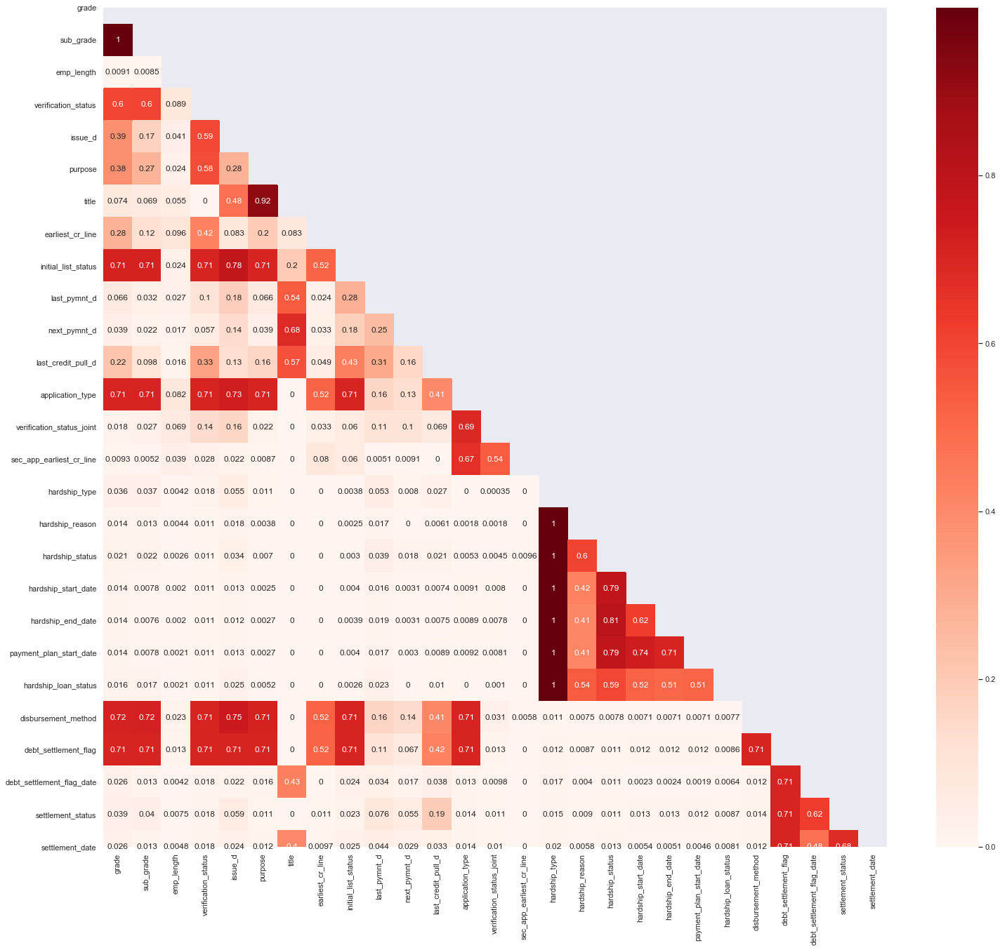

In [163]:
mask_cram= np.triu(np.ones(cramers_.shape)).astype(np.bool)
#print(mask_cram)
mp.figure(figsize=(25,22))
sns.heatmap(cramers_, mask=mask_cram,annot=True, cmap="Reds")
mp.show()

In [164]:
(list(Correlation_.keys()))

[('grade', 'sub_grade'),
 ('sub_grade', 'grade'),
 ('purpose', 'title'),
 ('title', 'purpose'),
 ('hardship_type', 'hardship_reason'),
 ('hardship_type', 'hardship_status'),
 ('hardship_type', 'hardship_start_date'),
 ('hardship_type', 'hardship_end_date'),
 ('hardship_type', 'payment_plan_start_date'),
 ('hardship_type', 'hardship_loan_status'),
 ('hardship_reason', 'hardship_type'),
 ('hardship_status', 'hardship_type'),
 ('hardship_status', 'hardship_end_date'),
 ('hardship_start_date', 'hardship_type'),
 ('hardship_end_date', 'hardship_type'),
 ('hardship_end_date', 'hardship_status'),
 ('payment_plan_start_date', 'hardship_type'),
 ('hardship_loan_status', 'hardship_type')]

### From Cramers V correlation it can be said that some of the features are highly correlated with each other (grade and sub_grade) while the Theil U coefficient inform about the importance of a particular feature which indicates directly towards the target variable.  So first I will keep those object type variables which have good enough information about the target variables and then remove the object type variables which are highly correlated among themselves.

In [165]:
columns_drop = ['sub_grade','title','hardship_reason','hardship_start_date','hardship_end_date','payment_plan_start_date','hardship_loan_status']

In [166]:
obj_data.drop(columns_drop,axis=1,inplace=True)

In [167]:
obj_data.drop(['hardship_type'],axis=1,inplace=True)

In [168]:
obj_data.head(5).style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

,grade,emp_length,verification_status,issue_d,purpose,earliest_cr_line,initial_list_status,last_pymnt_d,next_pymnt_d,last_credit_pull_d,application_type,verification_status_joint,sec_app_earliest_cr_line,hardship_status,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date
0,C,11 years,Not Verified,Dec-2015,debt_consolidation,Aug-2003,w,Jan-2019,,Mar-2019,Individual,,,,Cash,N,,,
1,C,11 years,Not Verified,Dec-2015,small_business,Dec-1999,w,Jun-2016,,Mar-2019,Individual,,,,Cash,N,,,
2,B,11 years,Not Verified,Dec-2015,home_improvement,Aug-2000,w,Jun-2017,,Mar-2019,Joint App,Not Verified,,,Cash,N,,,
3,C,11 years,Source Verified,Dec-2015,debt_consolidation,Sep-2008,w,Feb-2019,Apr-2019,Mar-2019,Individual,,,,Cash,N,,,
4,F,3 years,Source Verified,Dec-2015,major_purchase,Jun-1998,w,Jul-2016,,Mar-2018,Individual,,,,Cash,N,,,


In [169]:
fl_data =df_2.select_dtypes('float64')

In [172]:
obj_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2260701 entries, 0 to 2260700
Data columns (total 19 columns):
 #   Column                     Dtype 
---  ------                     ----- 
 0   grade                      object
 1   emp_length                 object
 2   verification_status        object
 3   issue_d                    object
 4   purpose                    object
 5   earliest_cr_line           object
 6   initial_list_status        object
 7   last_pymnt_d               object
 8   next_pymnt_d               object
 9   last_credit_pull_d         object
 10  application_type           object
 11  verification_status_joint  object
 12  sec_app_earliest_cr_line   object
 13  hardship_status            object
 14  disbursement_method        object
 15  debt_settlement_flag       object
 16  debt_settlement_flag_date  object
 17  settlement_status          object
 18  settlement_date            object
dtypes: object(19)
memory usage: 327.7+ MB


In [173]:
obj_data['issue_d']=obj_data['issue_d'].fillna('')

In [174]:
obj_data['last_pymnt_d']=obj_data['last_pymnt_d'].fillna('')

In [175]:
obj_data['next_pymnt_d']=obj_data['next_pymnt_d'].fillna('')

In [176]:
obj_data['last_credit_pull_d'] = obj_data['last_credit_pull_d'].fillna('')

In [177]:
obj_data.isnull().mean()

grade                        0.0
emp_length                   0.0
verification_status          0.0
issue_d                      0.0
purpose                      0.0
earliest_cr_line             0.0
initial_list_status          0.0
last_pymnt_d                 0.0
next_pymnt_d                 0.0
last_credit_pull_d           0.0
application_type             0.0
verification_status_joint    0.0
sec_app_earliest_cr_line     0.0
hardship_status              0.0
disbursement_method          0.0
debt_settlement_flag         0.0
debt_settlement_flag_date    0.0
settlement_status            0.0
settlement_date              0.0
dtype: float64

In [178]:
obj_data.nunique()

grade                          8
emp_length                    12
verification_status            4
issue_d                      140
purpose                       15
earliest_cr_line             755
initial_list_status            3
last_pymnt_d                 137
next_pymnt_d                 107
last_credit_pull_d           142
application_type               3
verification_status_joint      4
sec_app_earliest_cr_line     664
hardship_status                4
disbursement_method            3
debt_settlement_flag           3
debt_settlement_flag_date     84
settlement_status              4
settlement_date               91
dtype: int64

### Some of the object features are of very high cardinality. one hot encoding will make a feature explosion. The following link and library mentions about some ways to deal with features with very high cardinality. http://contrib.scikit-learn.org/category_encoders/index.html. I can use hashing but the hashing algorithm may put different categories in the same group--might affect the target negatively. Other way around is the target encoding which is explained quite well in the following link--https://maxhalford.github.io/blog/target-encoding/

### I could have used the mean encoding. However, I decide to follow the Laplace smoothing of the local mean. It is because if there is a very low occurence of a certain instance of a feature then its local mean cannot be trusted. Then a more heavy emphasis should be given on the global mean.

### Since this notebook has become very heavy. I will do all these in the other notebook where I will also perform machine learning using pycaret.

In [179]:
data_final=pd.concat([fl_data,obj_data],axis=1)

In [190]:
data_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2260701 entries, 0 to 2260700
Data columns (total 98 columns):
 #   Column                               Dtype  
---  ------                               -----  
 0   loan_amnt                            float64
 1   int_rate                             float64
 2   annual_inc                           float64
 3   dti                                  float64
 4   delinq_2yrs                          float64
 5   fico_range_low                       float64
 6   inq_last_6mths                       float64
 7   mths_since_last_delinq               float64
 8   mths_since_last_record               float64
 9   open_acc                             float64
 10  pub_rec                              float64
 11  revol_bal                            float64
 12  revol_util                           float64
 13  total_acc                            float64
 14  out_prncp                            float64
 15  total_pymnt                     

In [180]:
data_final.to_csv('Data/Lending_Club_clean.csv')

In [181]:
#df_2['issue_d'].map(df_2.groupby('issue_d')['loan_status_binary'].mean())
#(df_2.groupby('issue_d')['loan_status_binary'].count()/df_2.groupby('issue_d')['loan_status_binary'].count().values.sum())

In [187]:
#Counter(list((df_2.groupby('issue_d')['loan_status'].count().apply(lambda x: x if x>200 else None).notnull().astype(int))))

In [183]:
#smooth = additive_smoothing(df_2,'issue_d','loan_status',2)
#smooth

In [184]:
# ### The above command means that there are 14 occurence of counts less than 200 of a particular category. Thus it is possible to trust the local mean. I will give a low weight to the local mean (additive_smoothing(df, by, on, m):)